# Detectron2 Beginner's Tutorial -- AMMI 2023 CV Week 2 Lab 3

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

Welcome to detectron2! This is the official colab tutorial of detectron2. Here, we will go through some basics usage of detectron2, including the following:
* Run inference on images or videos, with an existing detectron2 model
* Train a detectron2 model on a new dataset

You can make a copy of this tutorial by "File -> Open in playground mode" and make changes there. __DO NOT__ request access to this tutorial.


# Install detectron2

## Run the following cell to install downlod and install the detector2

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 5.3 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15676, done.
remote: Counting objects: 100% (399/399), done.
remote: Compressing objects: 100% (304/304), done.
remote: Total 15676 (delta 177), reused 274 (delta 95), pack-reused 15277
Receiving objects: 100% (15676/15676), 6.51 MiB | 15.57 MiB/s, done.
Resolving deltas: 100% (11292/11292), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.0 MB/s eta 0:00

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.2 ; cuda:  cu121
detectron2: 0.6


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import matplotlib
# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

#Build a pre-trained detectron2 model and Traker

In [ ]:
class Tracker:

  def SetupWorkingSpace(self):
    from google.colab import drive # mount the  drive
    drive.mount('/content/drive')
    !cd "/content/drive/MyDrive/Computer Vision/Lab3" # Change the working to where you want to store your videos clips images or where you data set is stored in it
    #!wget https://github.com/gkioxari/aims2020_visualrecognition/releases/download/v1.0/videoclip.zip # download the videos clips from github
    #!unzip videoclip.zip # unzip

  def ReadPathImages(self):

    """
    Read all images inside your working directory
    ---
    input:
    directory to the imsges folder

    output:
    list of images_path
    """
    import os
    # folder path
    dir_path = r'/content/drive/MyDrive/Computer Vision/Lab3/clip'
    # list to store files
    images_path = []
    # Iterate directory
    for path in os.listdir(dir_path):
      if os.path.isfile(os.path.join(dir_path, path)):
        images_path.append(os.path.join(dir_path, path))
    images_path.sort(key=lambda x: int(x.split('/')[-1].split('.')[0]) )
    return images_path

  def LunchDetector(self):
    """
    Train a detectors2 model on your dataset
    ---
    input:
    lis of images path

    output:
    cfg(initial configuration of the model) , predictor
    """
    saved_out = []
    images_path = self.ReadPathImages()
    for image in images_path:
      im = cv2.imread(image)
      #cv2_imshow(im)
      #print(im.shape)
      cfg = get_cfg()
      # add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
      cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
      cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
      # Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
      cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
      predictor = DefaultPredictor(cfg)
      outputs = predictor(im)
      saved_out.append(outputs)
      # We can use `Visualizer` to draw the predictions on the image.
      v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
      out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
      cv2_imshow(out.get_image()[:, :, ::-1])
    return cfg , predictor

  def Train_traker(self,predictor, cfg, frames, view = False):
    """
    track all object in the frames
    ---
    input:
    predictor: the predictor we used for object tracking
    cfg: predictor configuration
    frames: list of images
    view_predicted_frames: bool, tell weather to view the predicted frames or not.

    output:
    predicted_frames: list of predicted frames
    """
  # all the colors
    All_Colors = list(matplotlib.colors.cnames.keys())
    predicted_frames = []

    # start by the first frame
    im = cv2.imread(frames[0])

    outputs = predictor(im)

    previous_boxes = outputs['instances'].pred_boxes
    pred_classes = outputs['instances'].pred_classes
    pred_masks = outputs['instances'].pred_masks

    # label to class name
    thing_classes = MetadataCatalog.get(cfg.DATASETS.TRAIN[0]).thing_classes

    classes = list(map(lambda x: thing_classes[x], pred_classes.cpu().numpy()))
    num_of_classes = len(classes)
    previous_colors = All_Colors[-1:-1*(num_of_classes)*3:-3]

    # visualizer
    v = Visualizer(im[:, :, ::-1], scale=1.2)
    out = v.overlay_instances(boxes=previous_boxes.tensor.cpu().numpy(), masks=pred_masks.cpu().numpy(), labels=classes, assigned_colors=previous_colors)
    if view:
      cv2_imshow(out.get_image()[:, :, ::-1])

    # append the predicted frames including the boxes
    predicted_frames.append(out.get_image()[:, :, ::-1])


    for im_path in frames[1: ]:

      im = cv2.imread(im_path)

      outputs = predictor(im)

      current_boxes = outputs['instances'].pred_boxes
      # scores = outputs['instances'].scores
      pred_classes = outputs['instances'].pred_classes
      pred_masks = outputs['instances'].pred_masks

      # thing_classes = MetadataCatalog.get(cfg.DATASETS.TRAIN[0]).thing_classes
      classes = list(map(lambda x: thing_classes[x], pred_classes.cpu().numpy()))
      # num_of_classes = len(classes)



      IOUs = detectron2.structures.pairwise_iou(current_boxes, previous_boxes)

      idx_matches = torch.argmax(IOUs, dim=1)

      for i,idx in enumerate(idx_matches):
        if IOUs[i][idx] < 0.4:
          idx_matches[i] = -1

      filtered_colors = list(filter(lambda x: x not in previous_colors, All_Colors))
      current_colors = []
      for idx in idx_matches:
        if idx == -1:
          filtered_colors = list(filter(lambda x: x not in current_colors, filtered_colors))
          current_colors.append(filtered_colors[-3])
        else:
          current_colors.append(previous_colors[idx])

      # update previous boxes and colors
      previous_boxes = current_boxes
      previous_colors = current_colors

      # visualizer
      v = Visualizer(im[:, :, ::-1], scale=1.2)
      out = v.overlay_instances(boxes=previous_boxes.tensor.cpu().numpy(), masks=pred_masks.cpu().numpy(), labels=classes, assigned_colors=previous_colors)
      if view:
        cv2_imshow(out.get_image()[:, :, ::-1])

      # append
      predicted_frames.append(out.get_image()[:, :, ::-1])

    return predicted_frames


In [ ]:
track = Tracker()

In [ ]:
track.SetupWorkingSpace()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
images_path=track.ReadPathImages()

In [ ]:
len(images_path)

41

[05/14 20:05:51 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


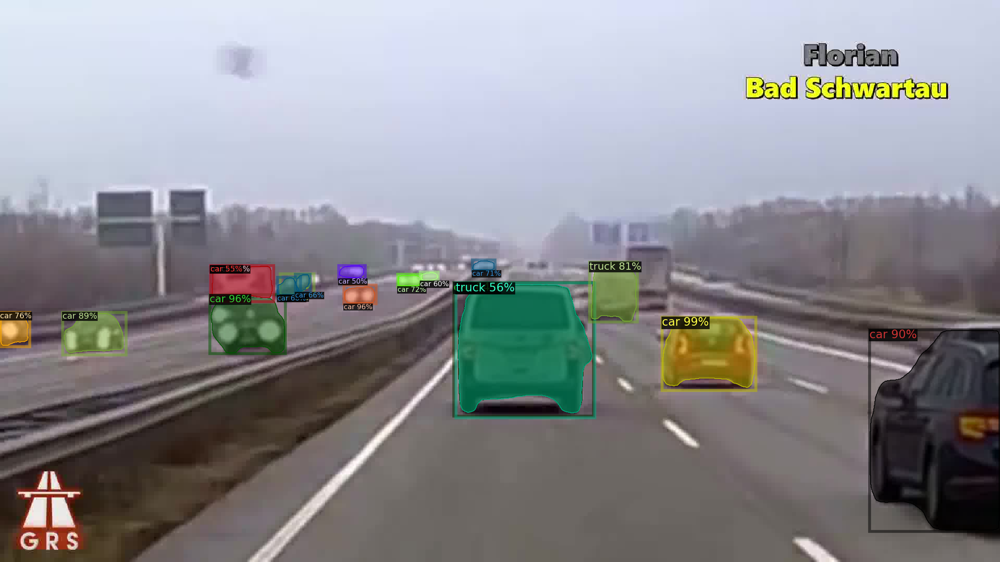

[05/14 20:05:53 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


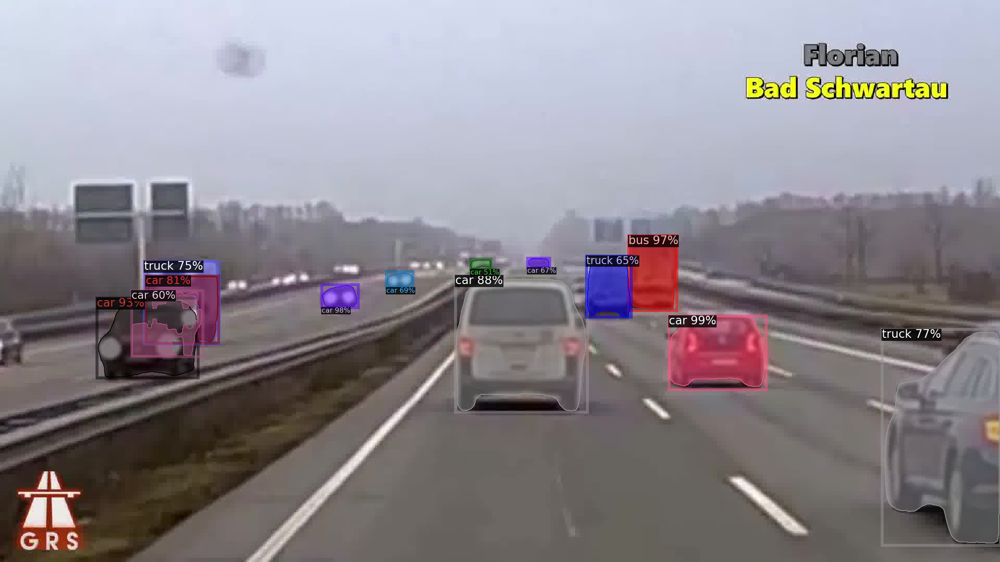

[05/14 20:05:56 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


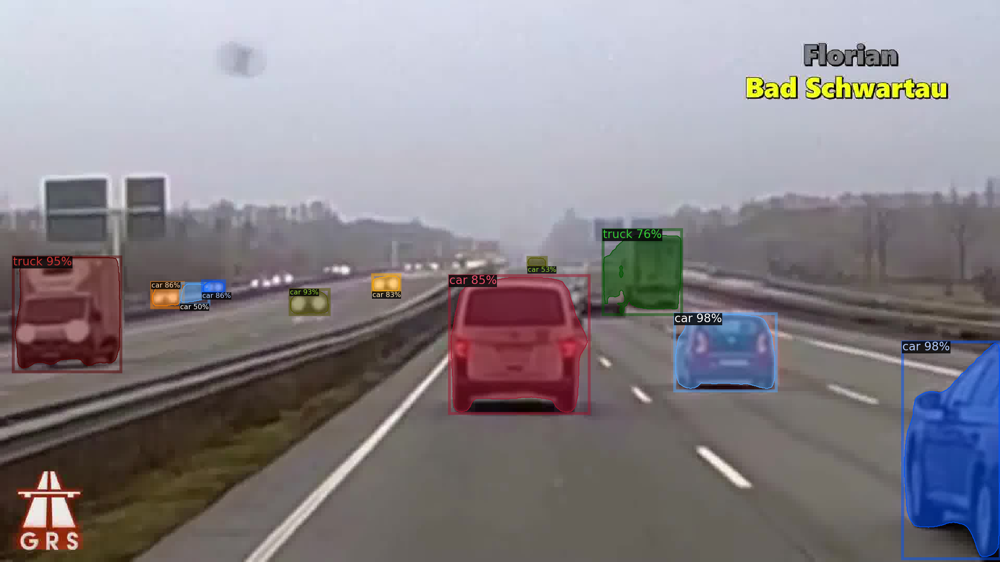

[05/14 20:06:00 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


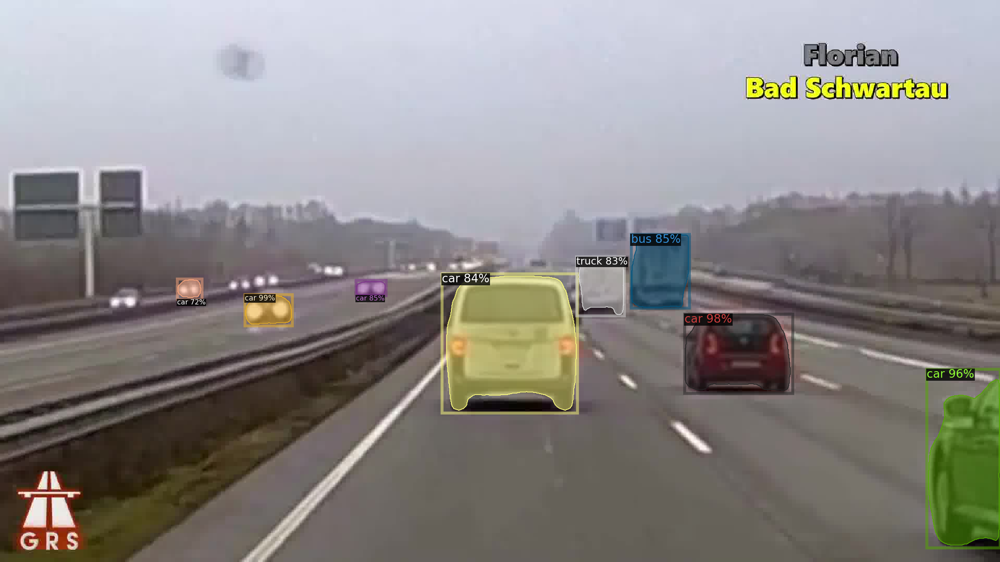

[05/14 20:06:03 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


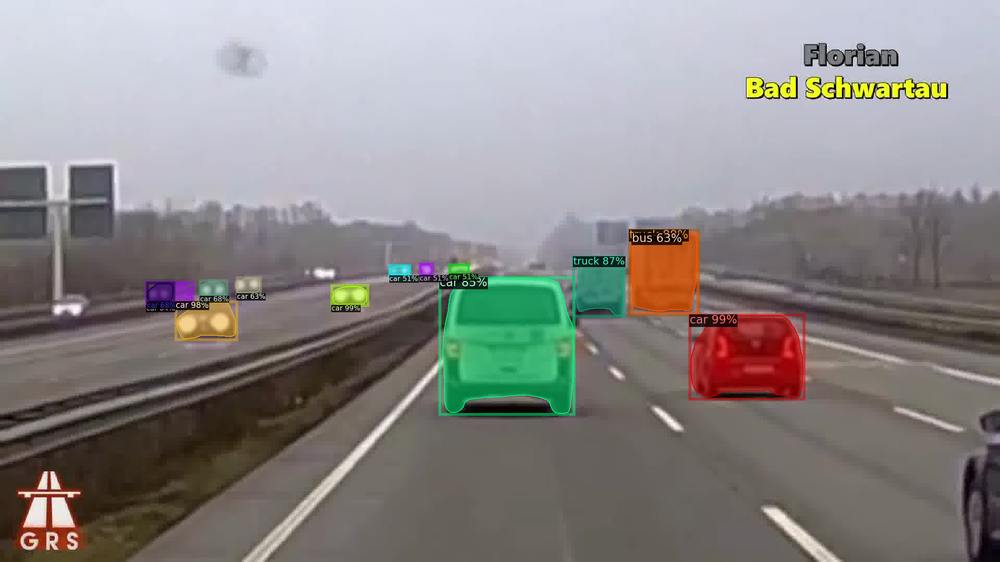

[05/14 20:06:06 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


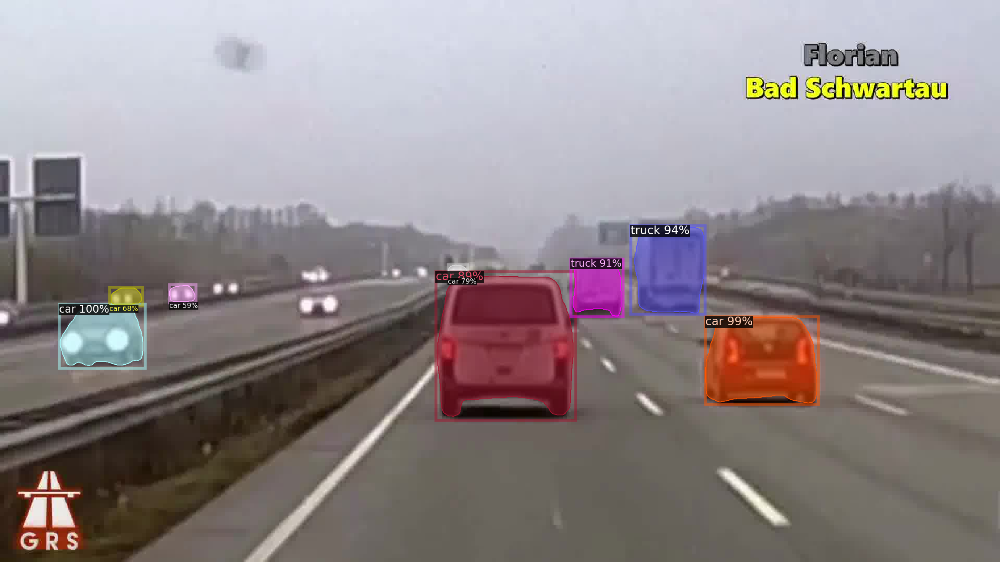

[05/14 20:06:09 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


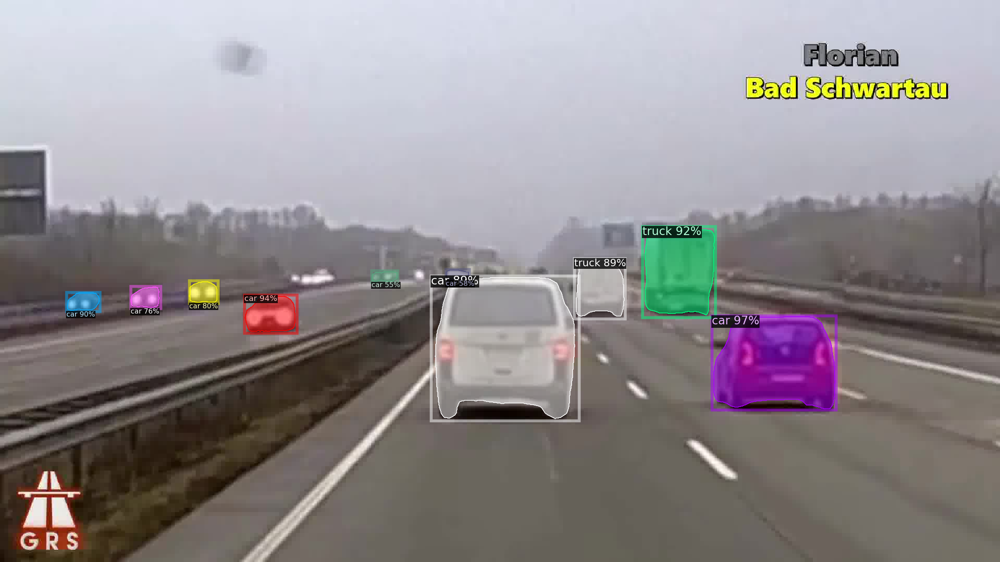

[05/14 20:06:12 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


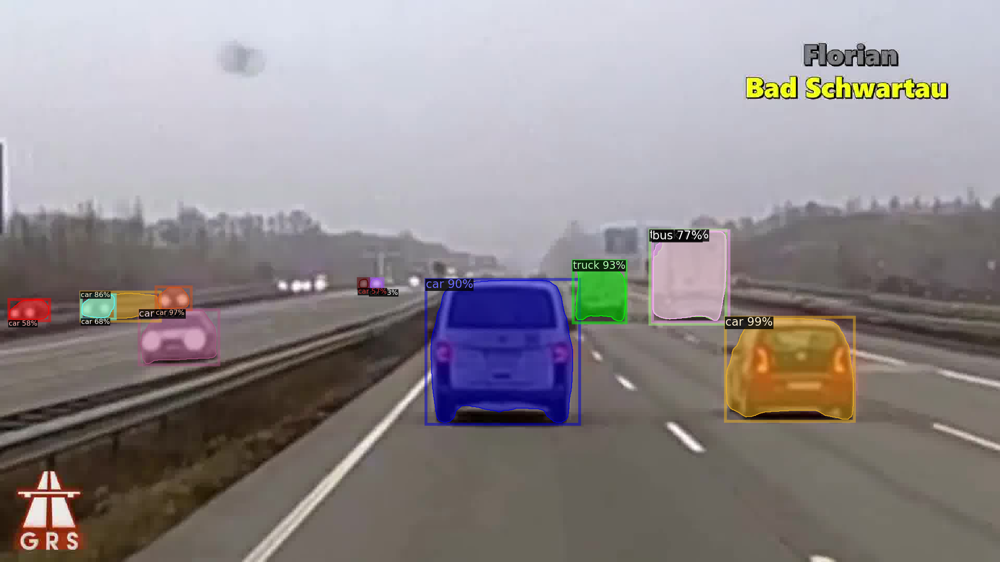

[05/14 20:06:14 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


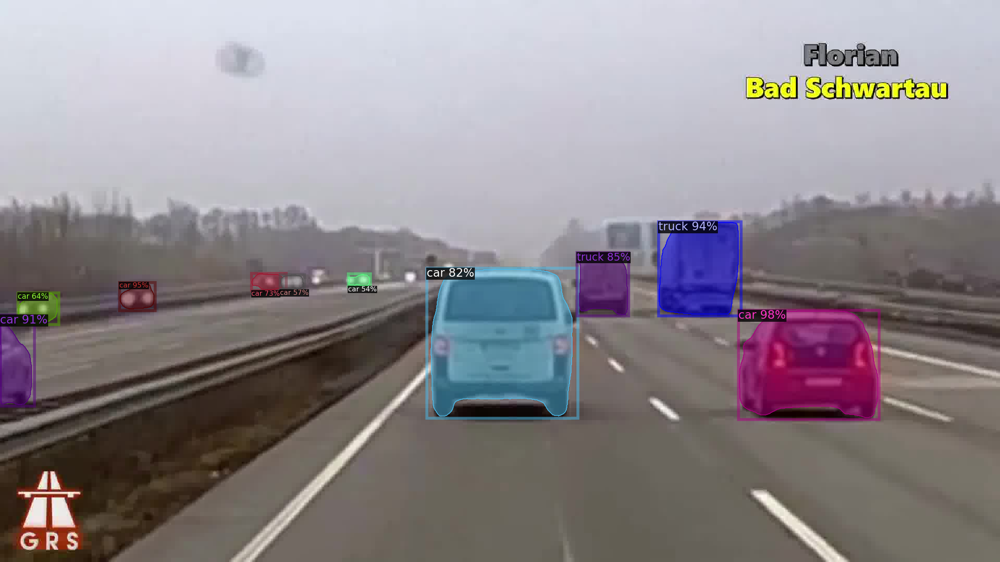

[05/14 20:06:16 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


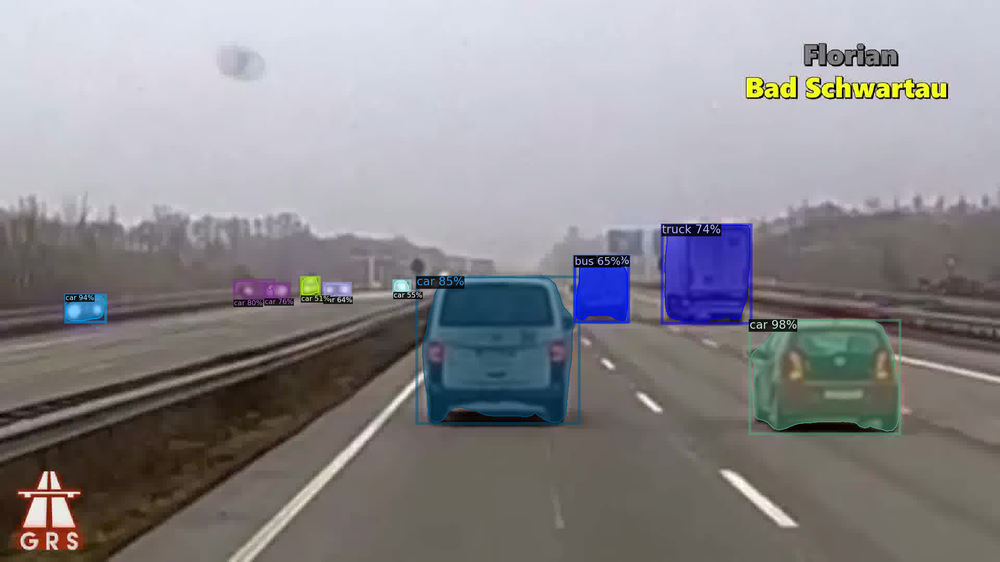

[05/14 20:06:18 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


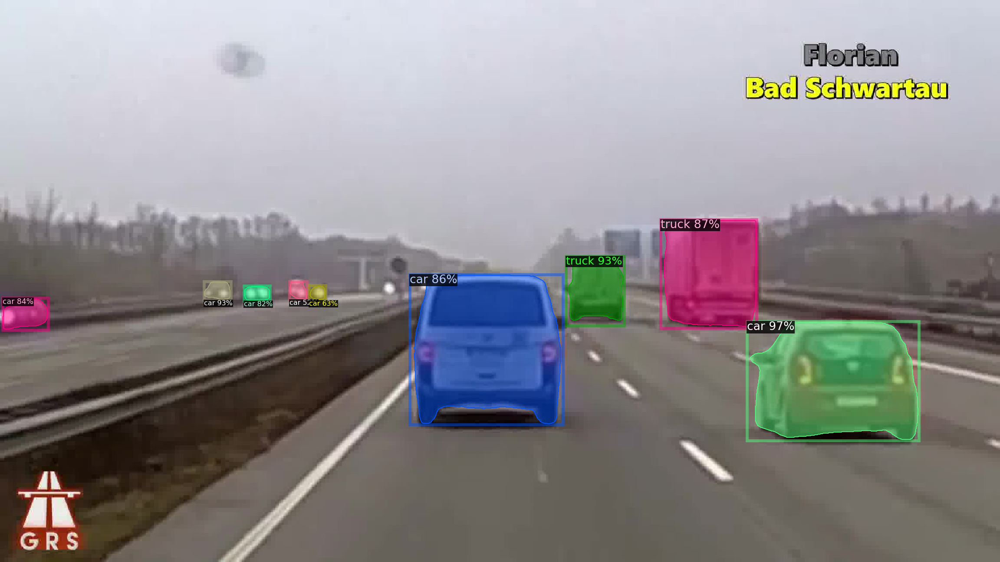

[05/14 20:06:19 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


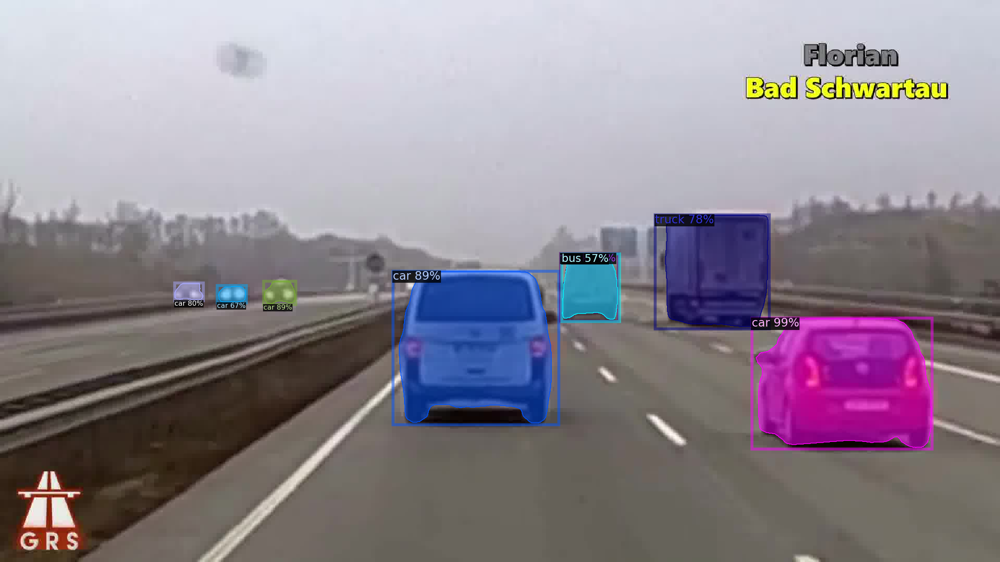

[05/14 20:06:21 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


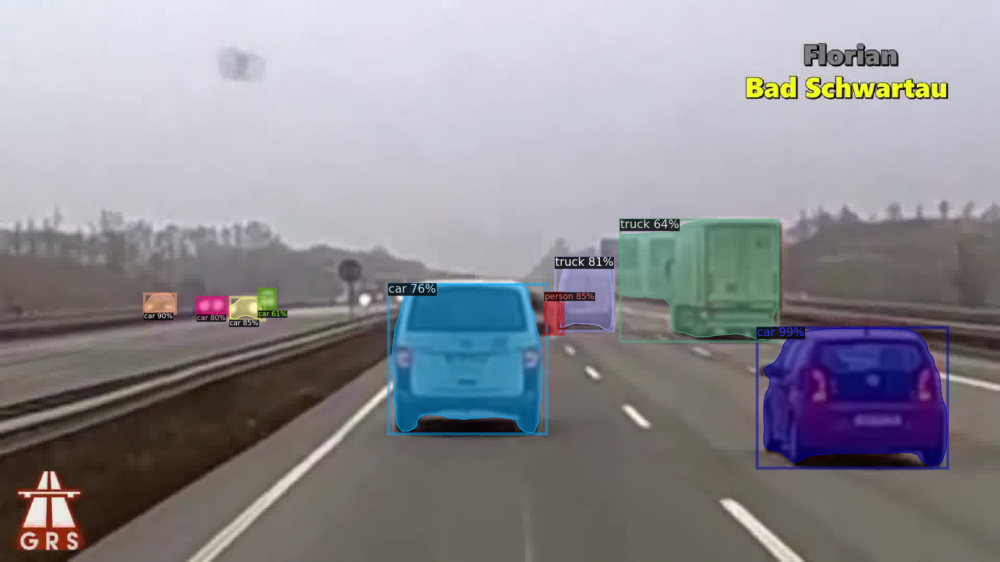

[05/14 20:06:23 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


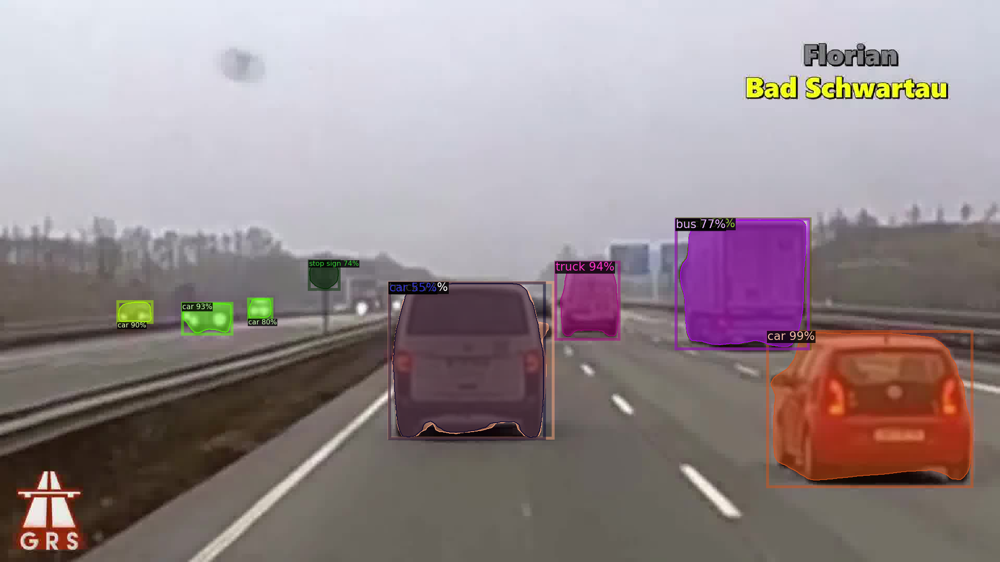

[05/14 20:06:25 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


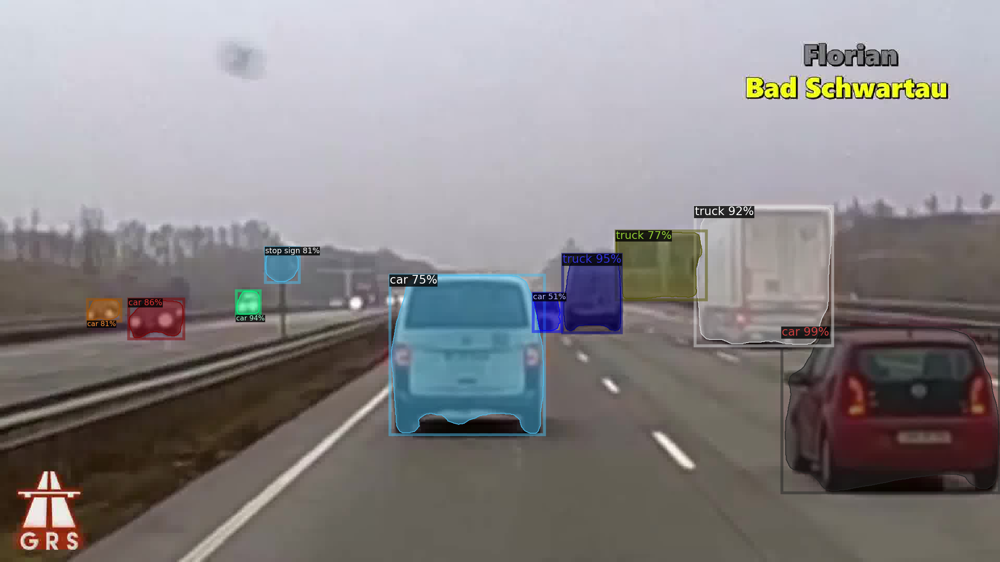

[05/14 20:06:28 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


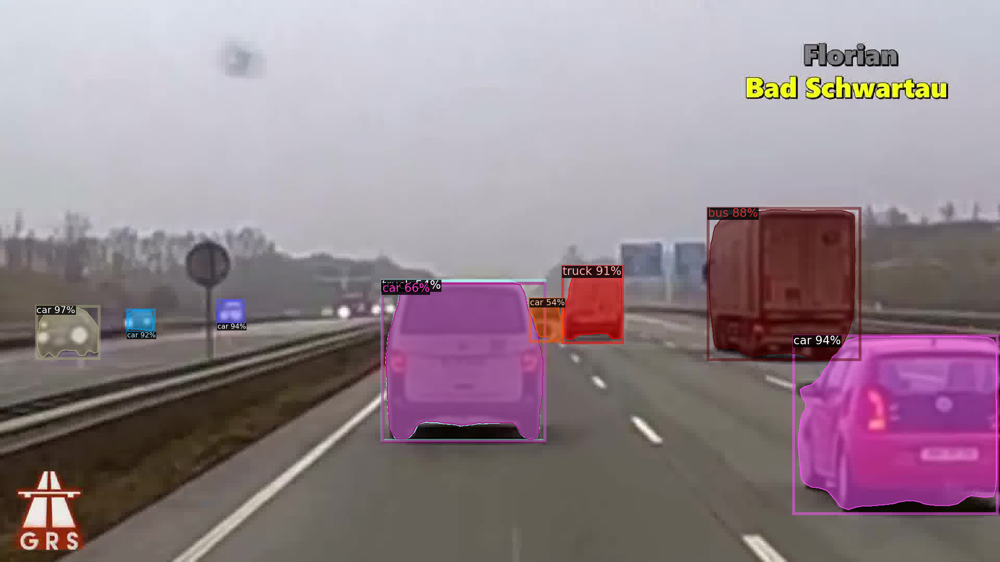

[05/14 20:06:30 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


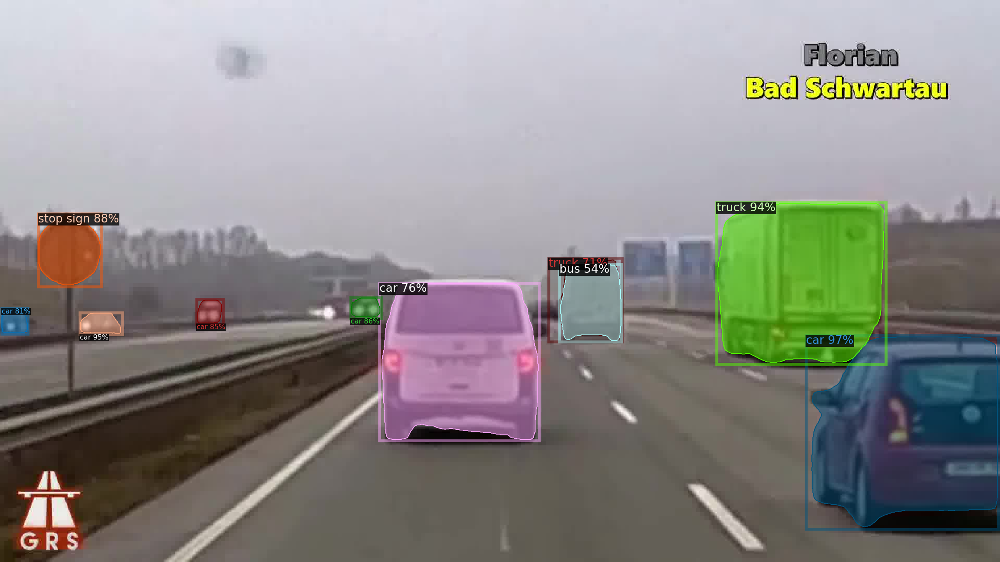

[05/14 20:06:32 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


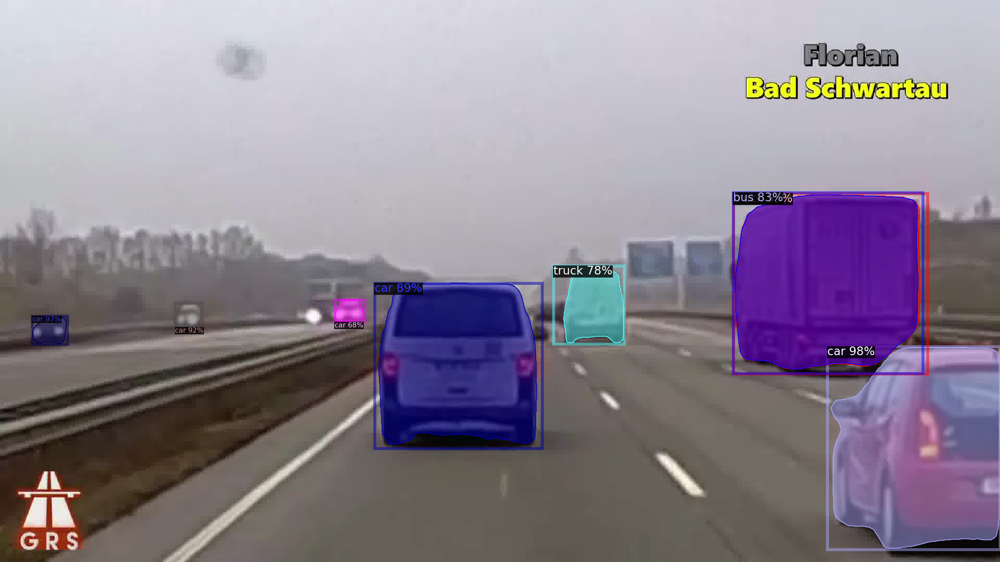

[05/14 20:06:34 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


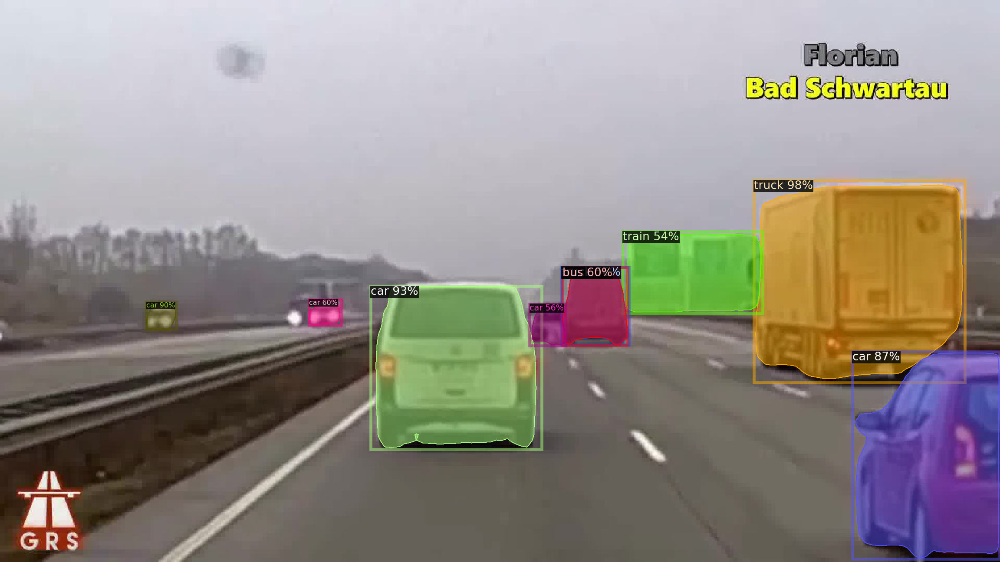

[05/14 20:06:36 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


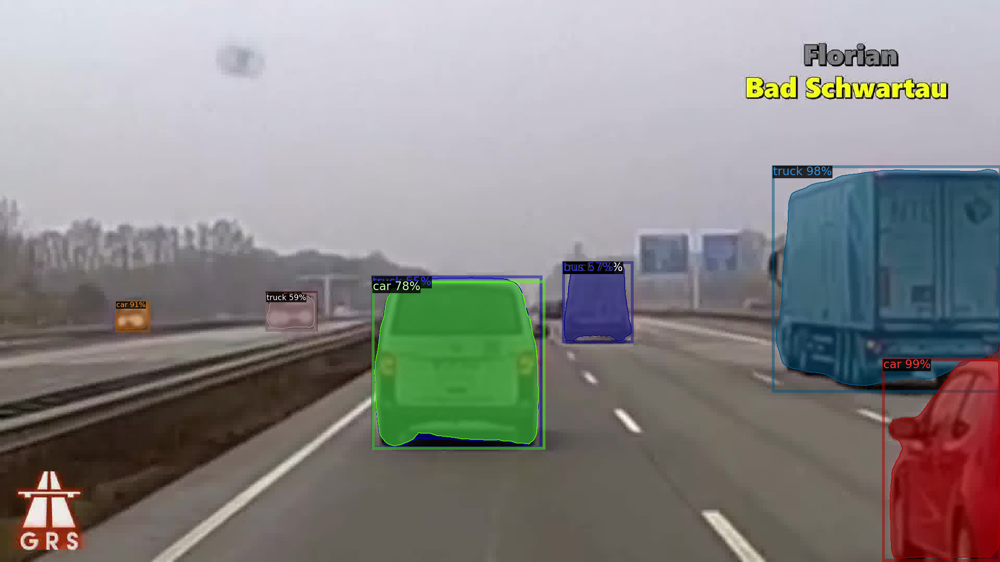

[05/14 20:06:38 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


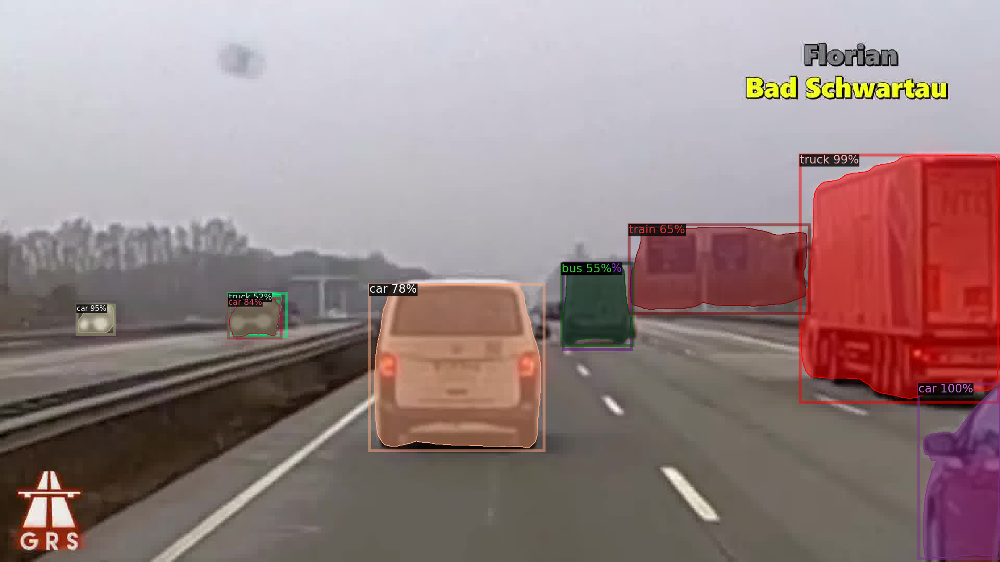

[05/14 20:06:41 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


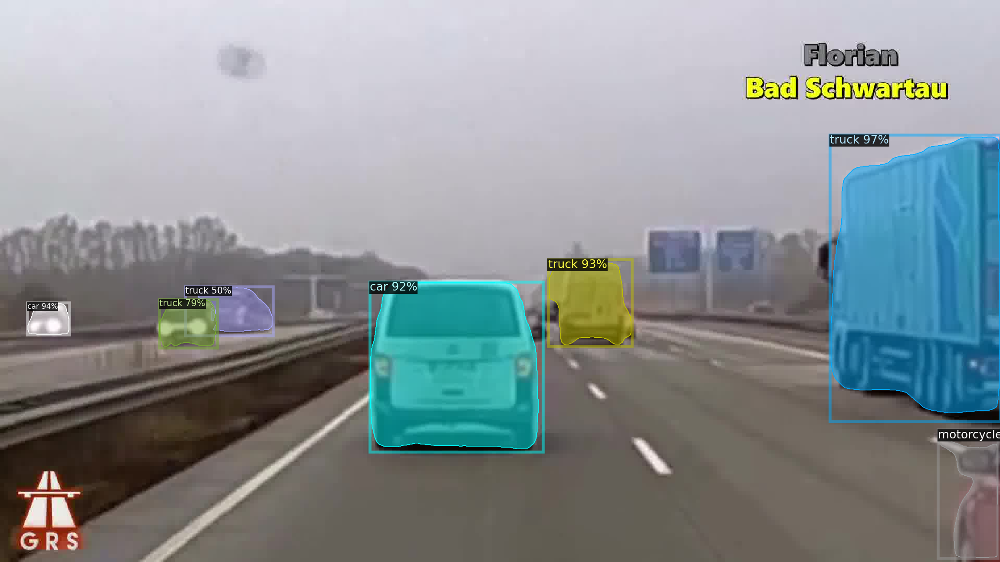

[05/14 20:06:44 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


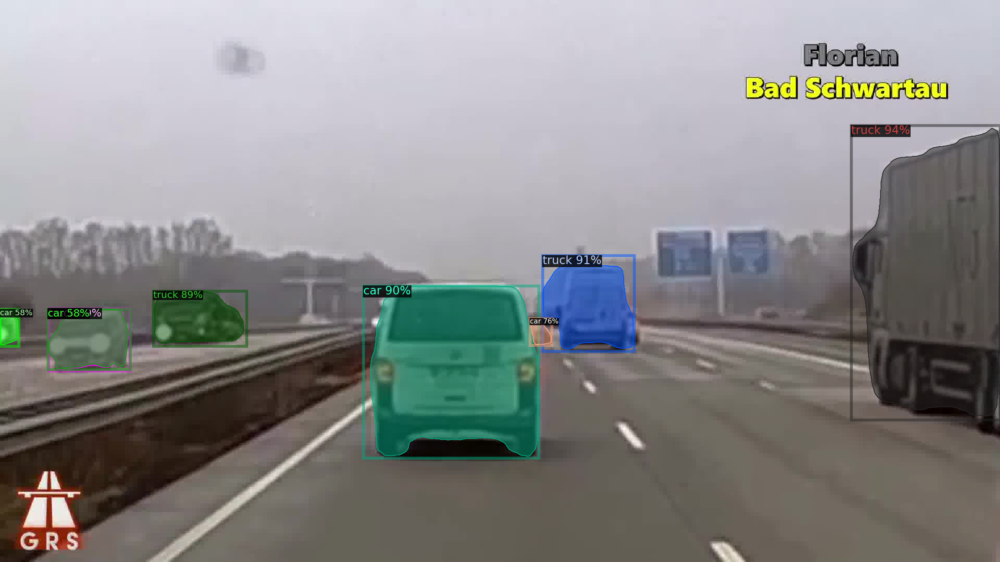

[05/14 20:06:45 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


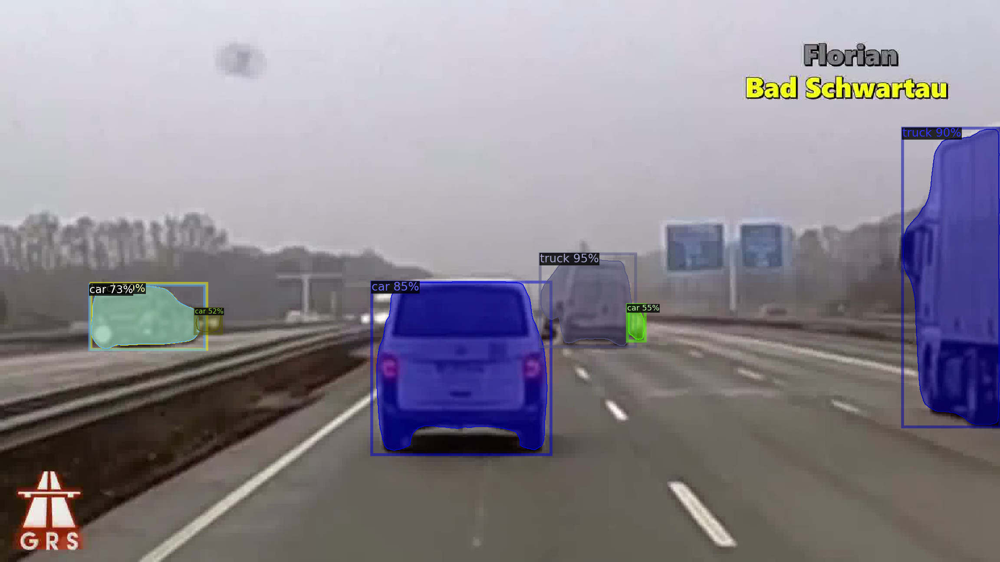

[05/14 20:06:47 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


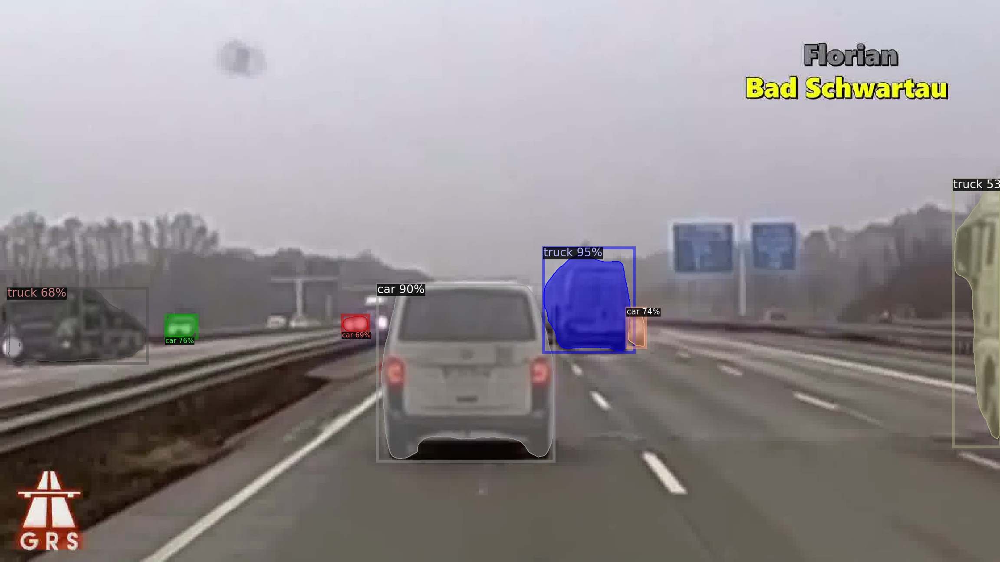

[05/14 20:06:49 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


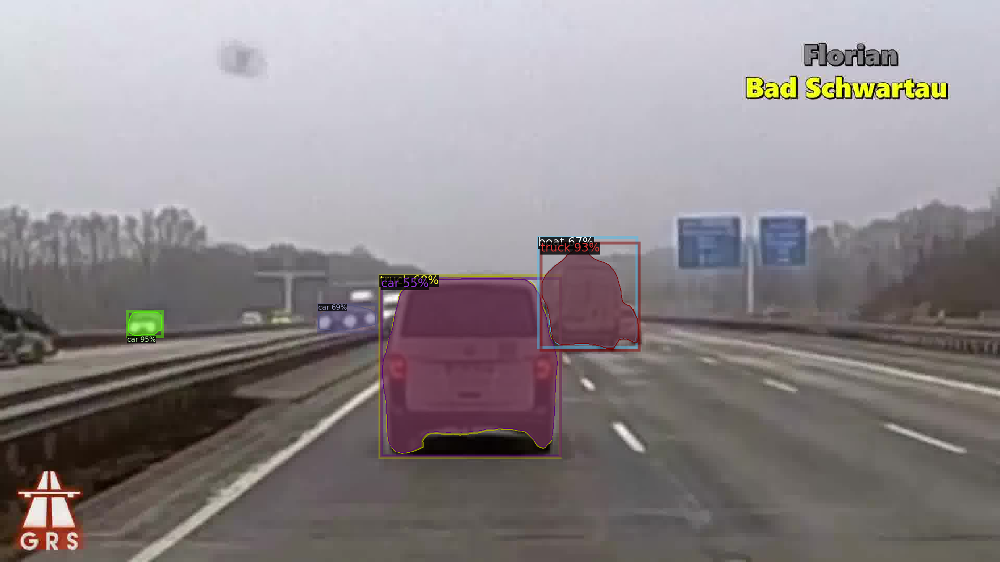

[05/14 20:06:51 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


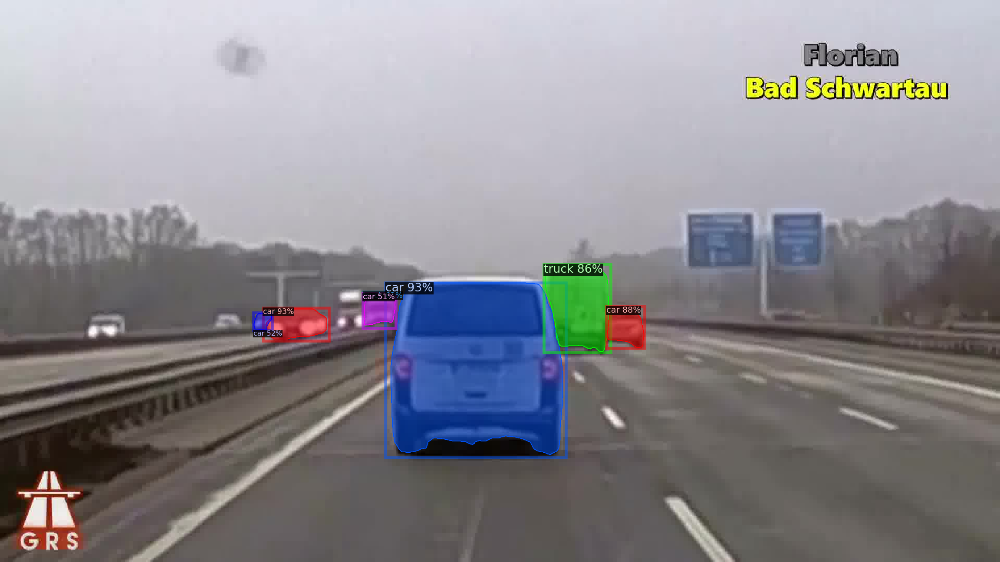

[05/14 20:06:53 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


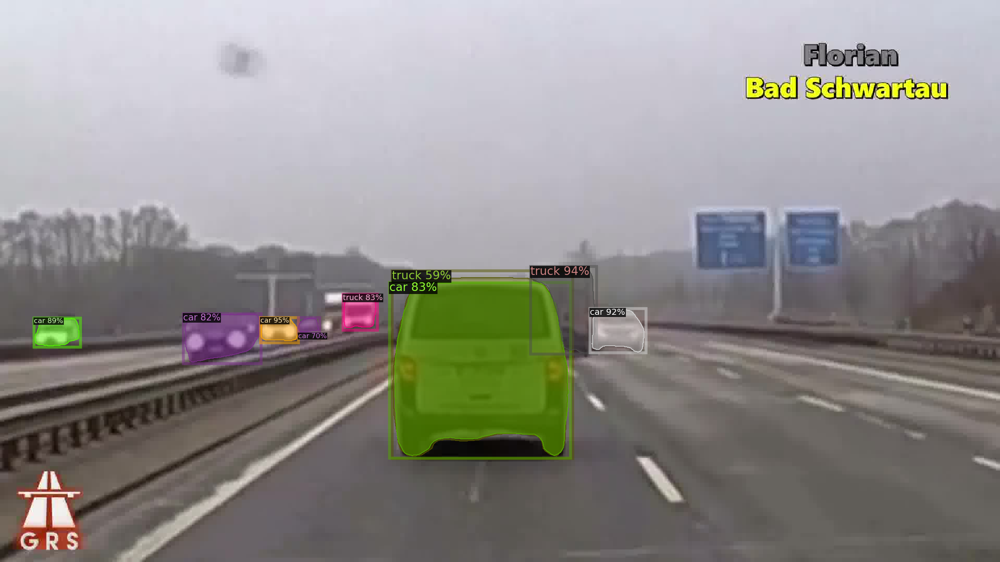

[05/14 20:06:55 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


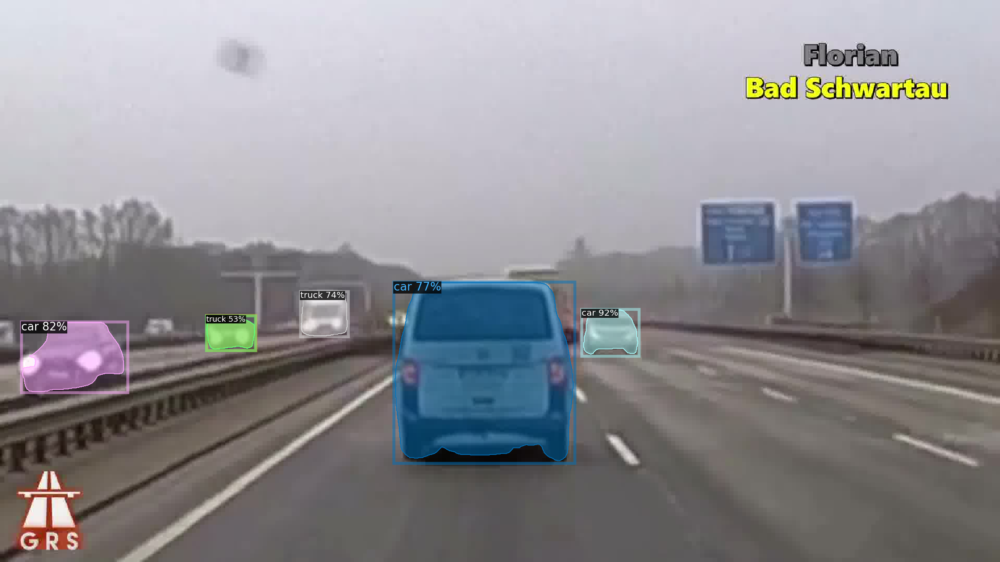

[05/14 20:06:58 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


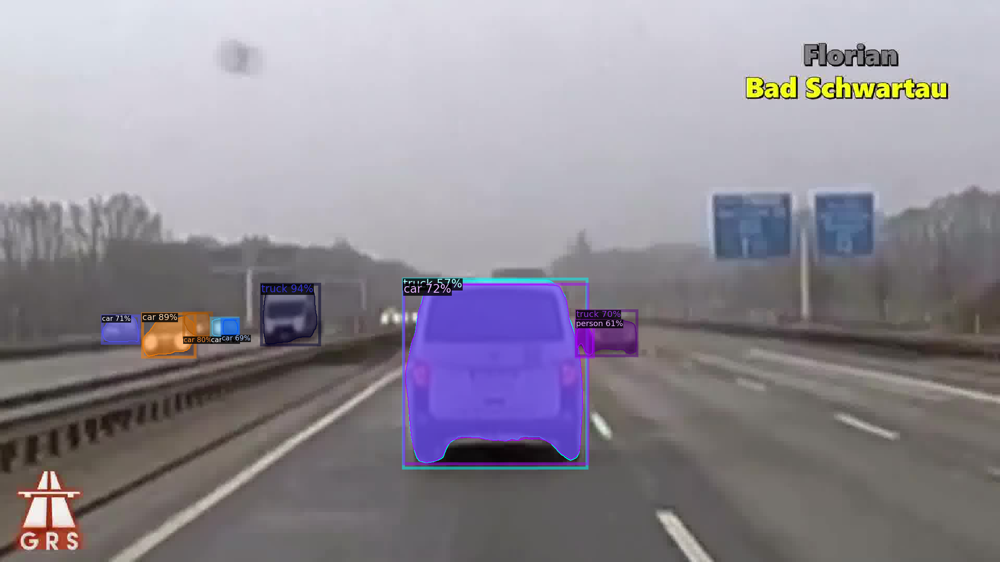

[05/14 20:07:00 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


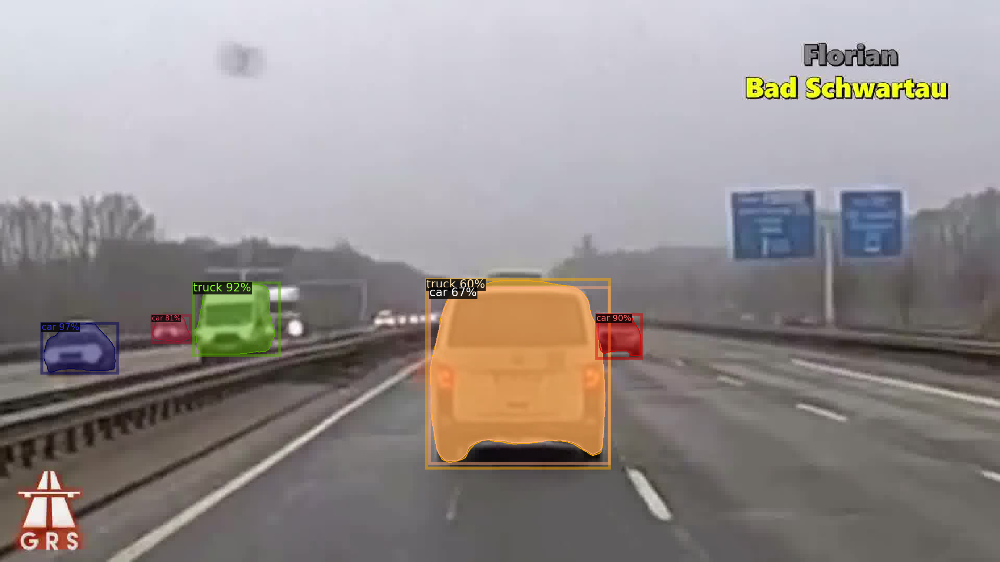

[05/14 20:07:01 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


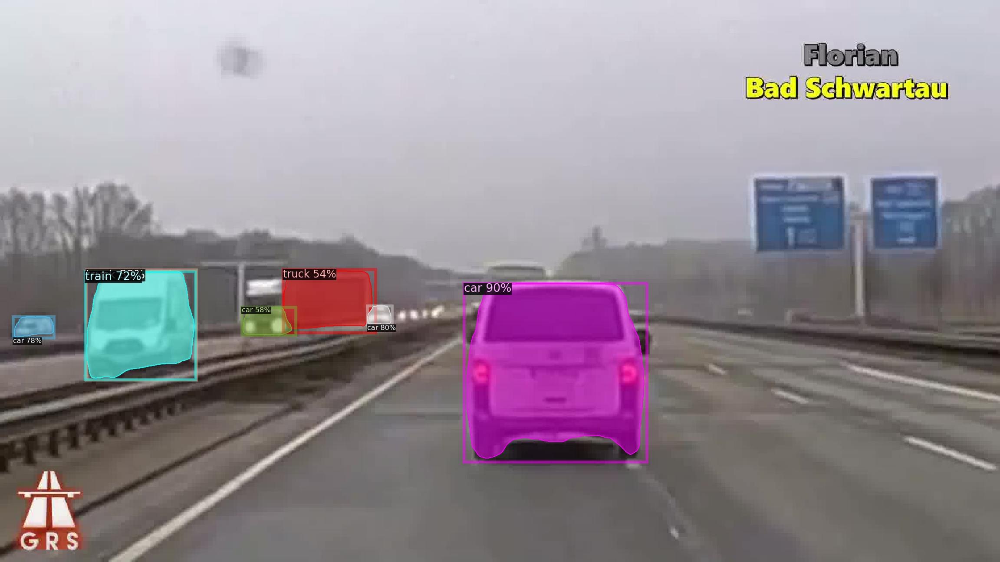

[05/14 20:07:03 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


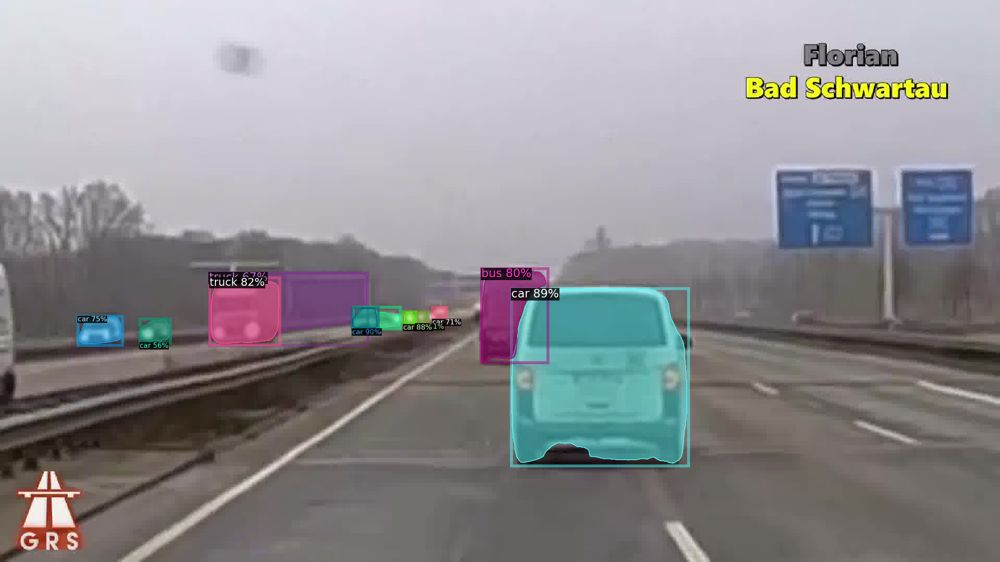

[05/14 20:07:05 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


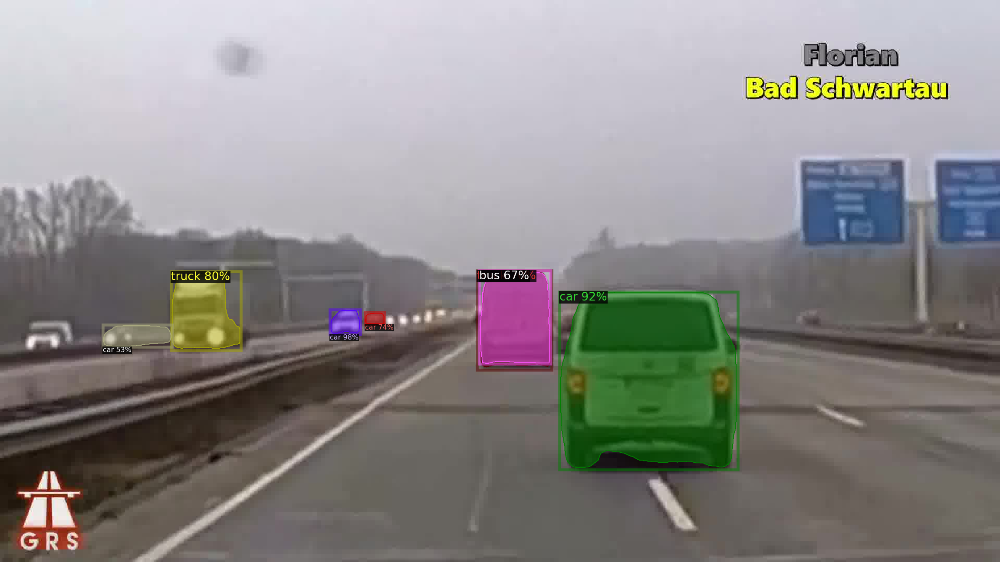

[05/14 20:07:07 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


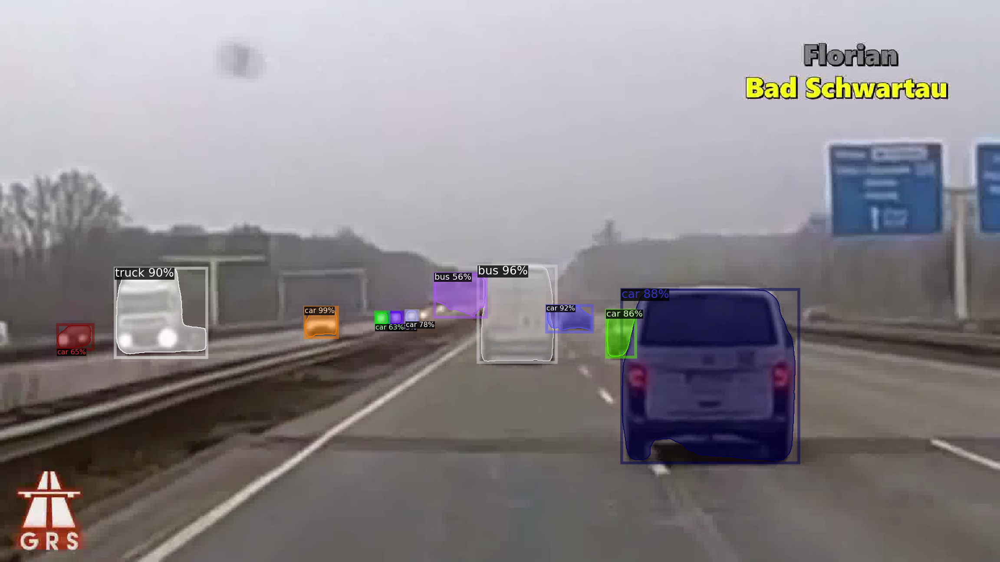

[05/14 20:07:10 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


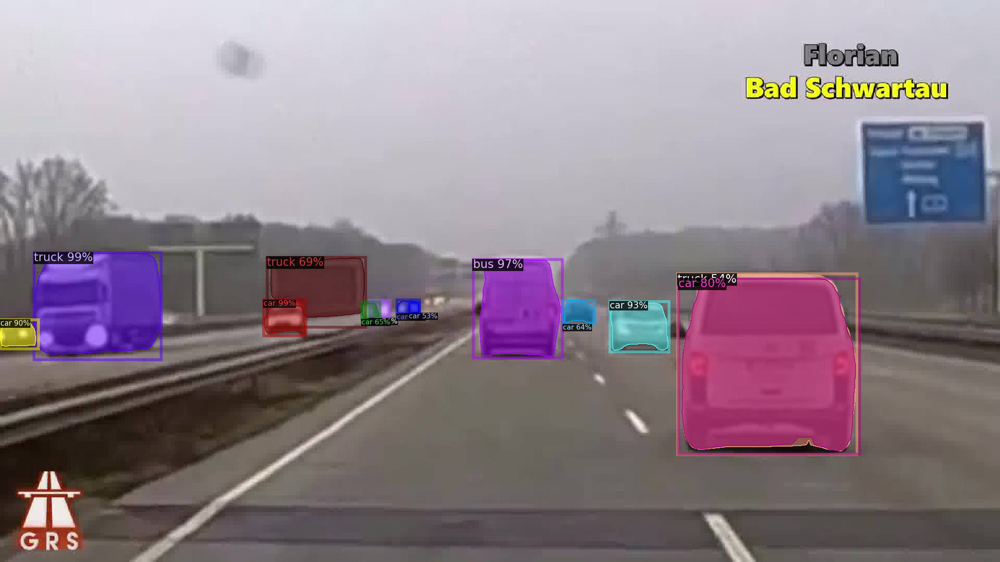

[05/14 20:07:13 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


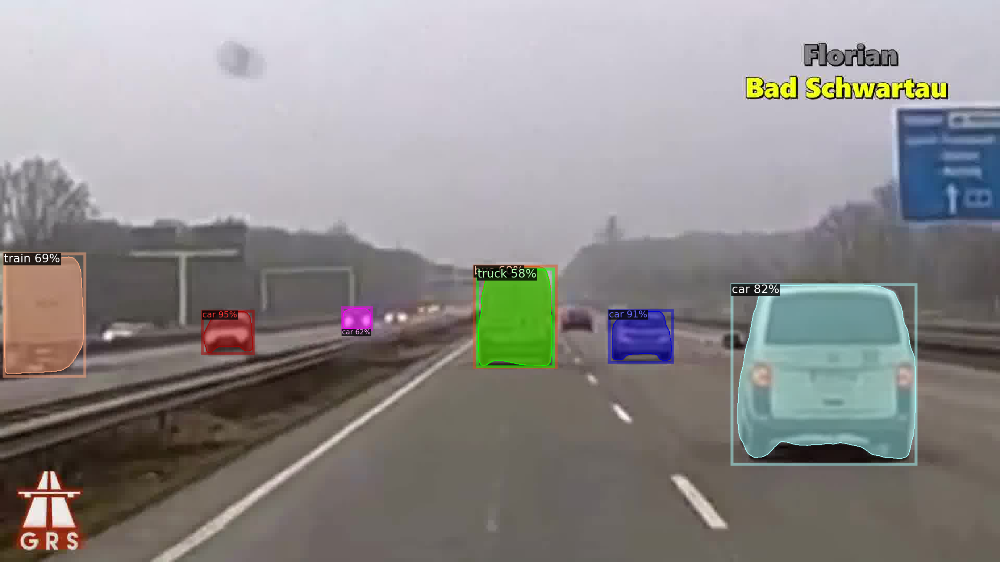

[05/14 20:07:14 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


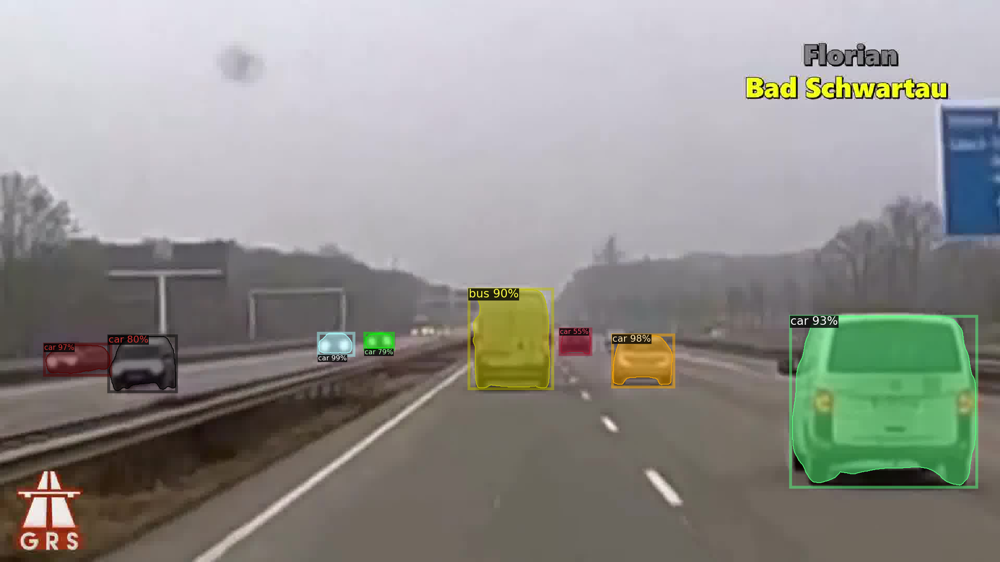

[05/14 20:07:16 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


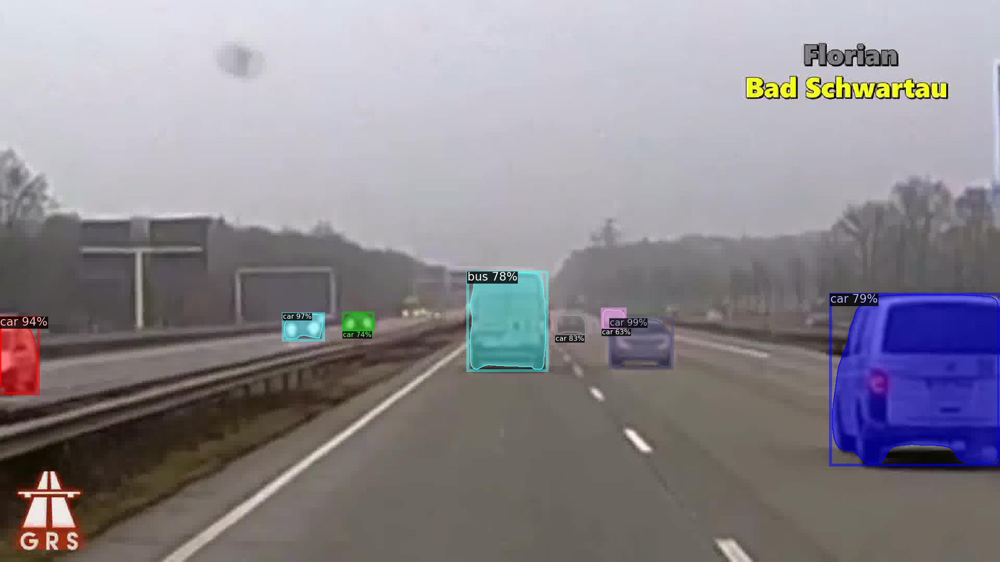

[05/14 20:07:18 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


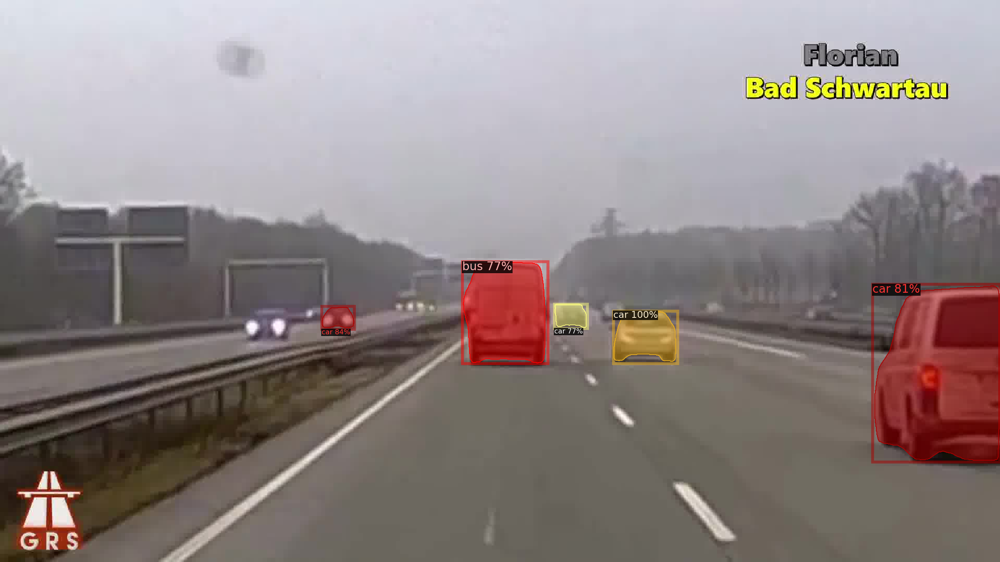

[05/14 20:07:20 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


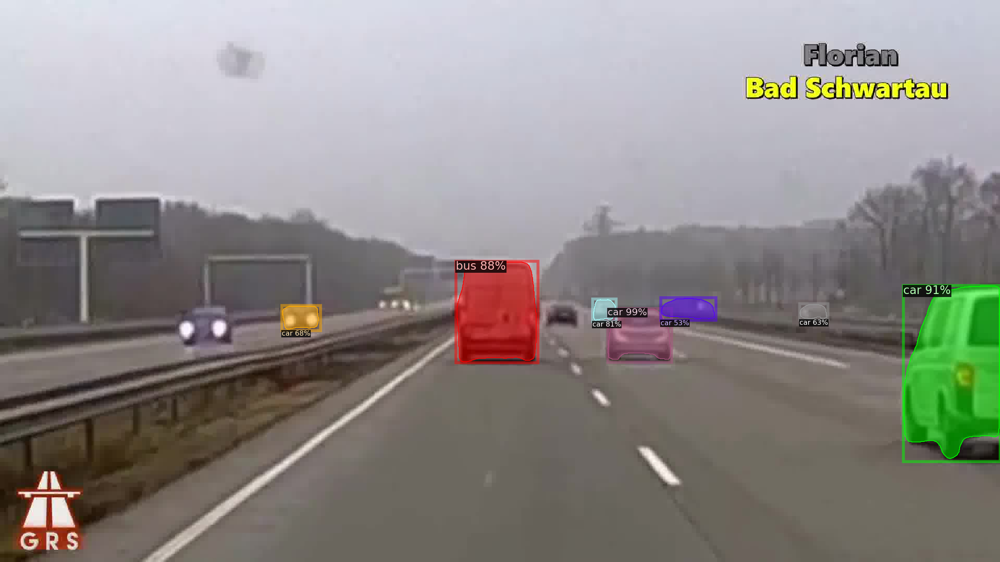

In [ ]:
cfg , predictor = track.LunchDetector()

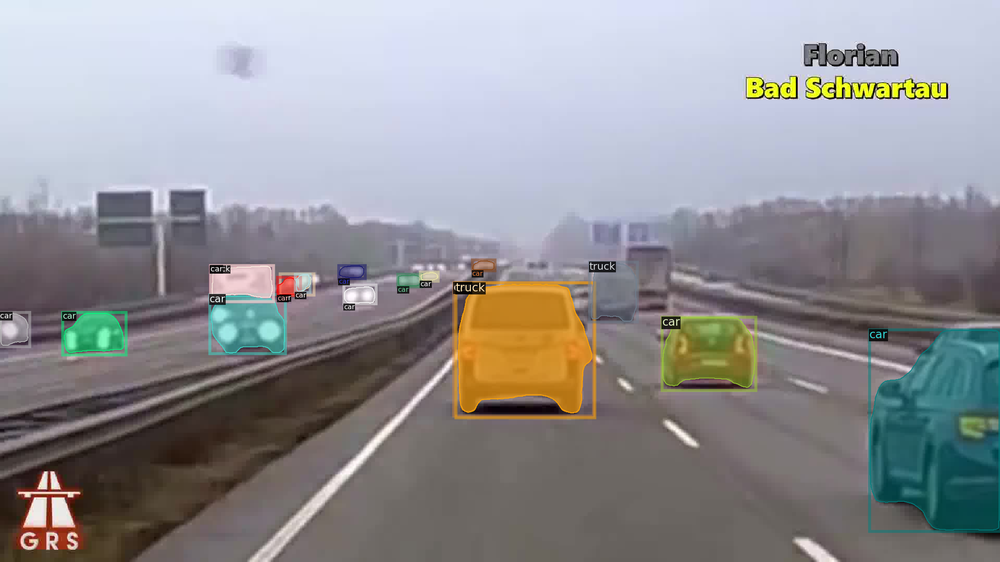

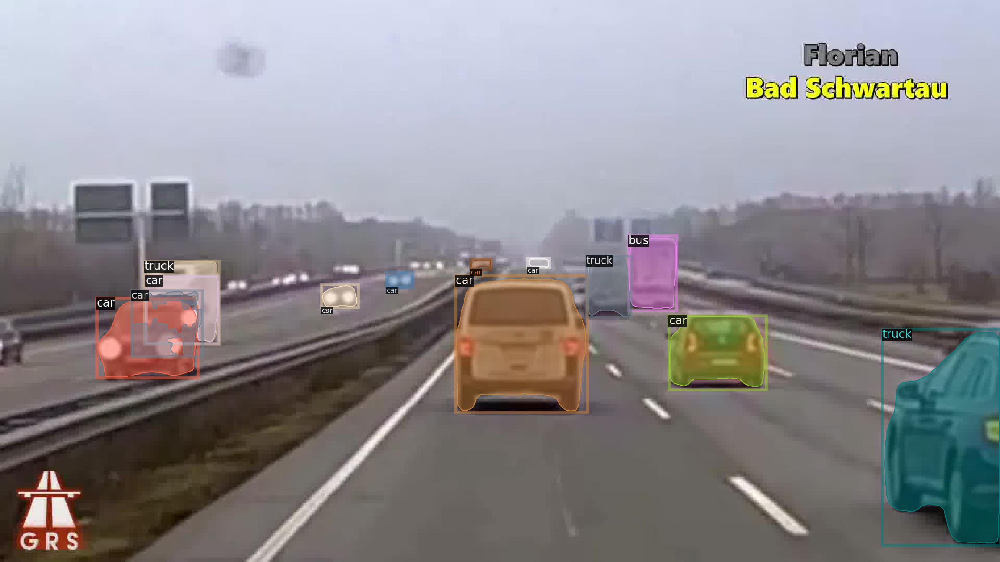

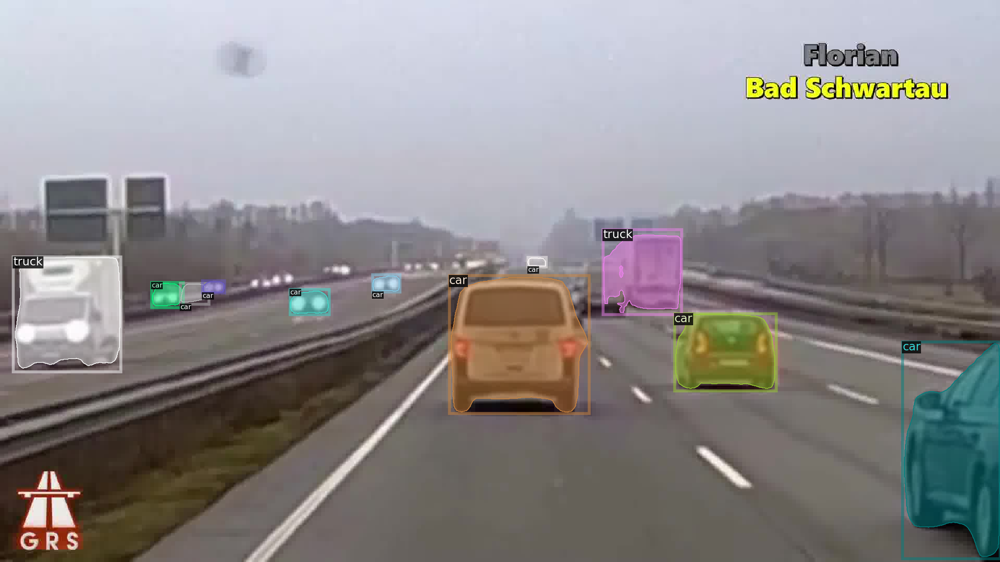

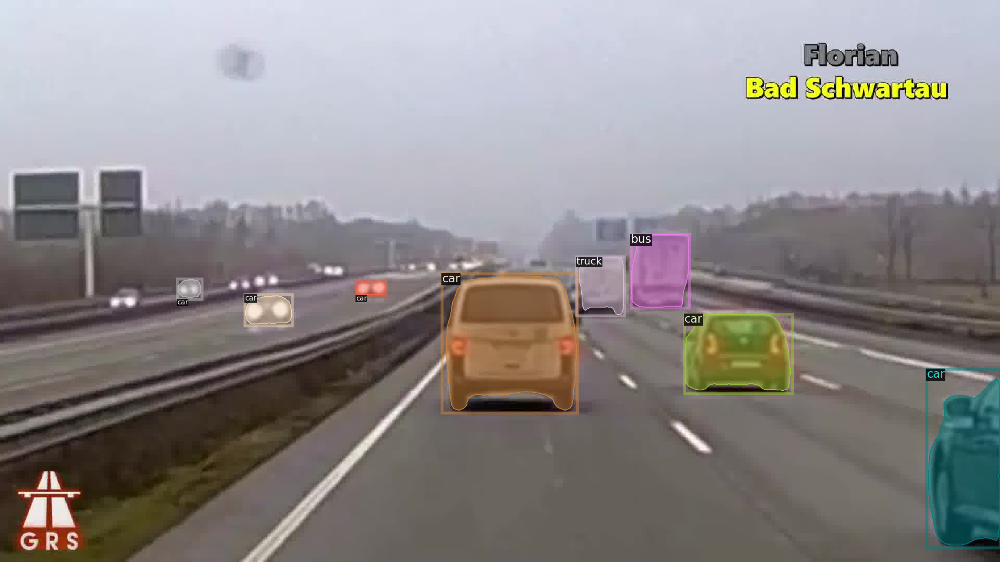

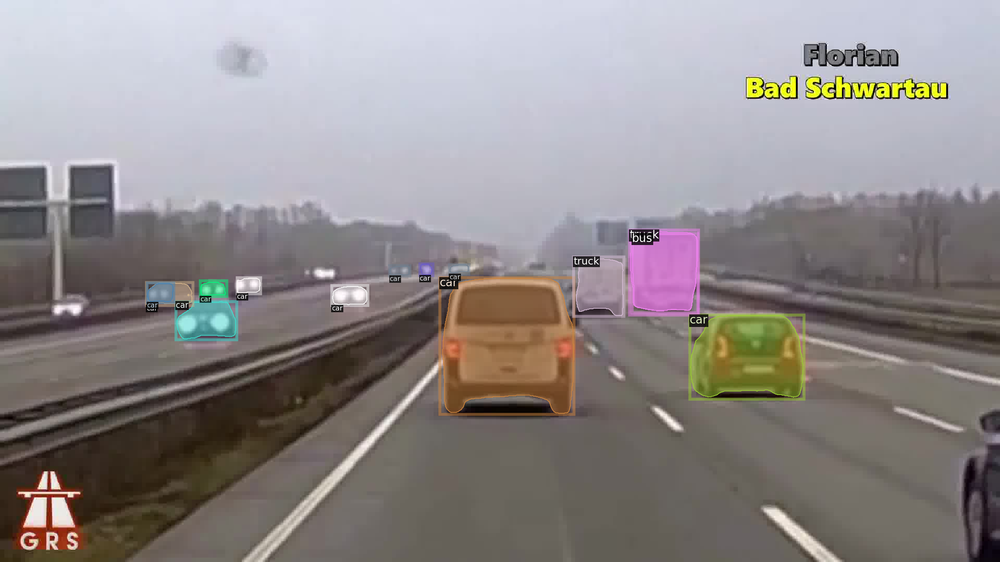

...

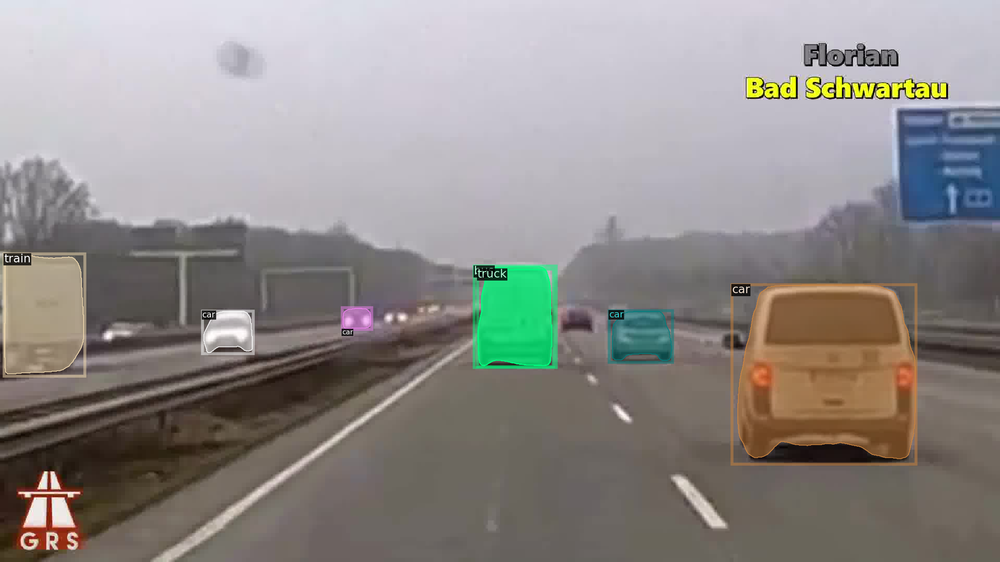

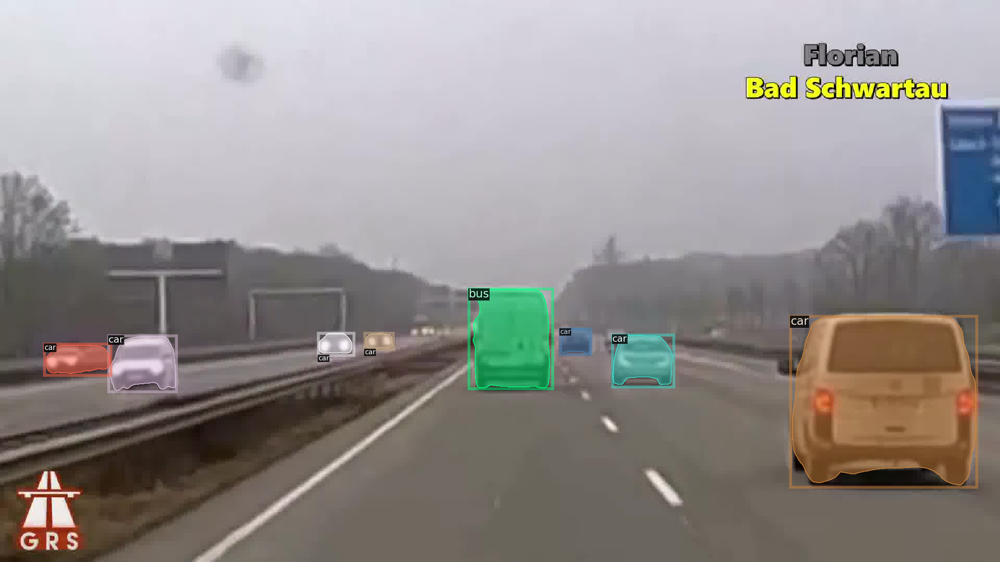

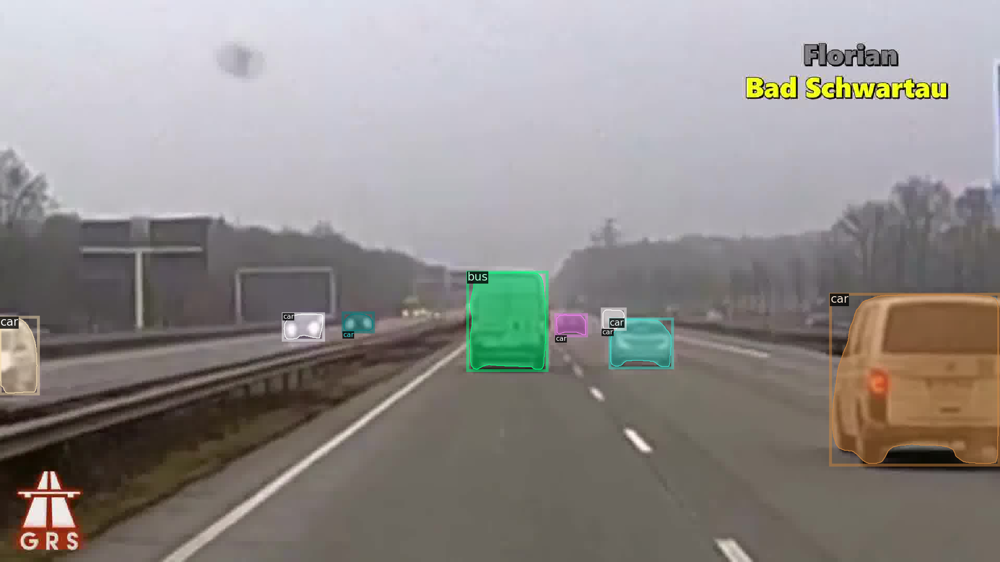

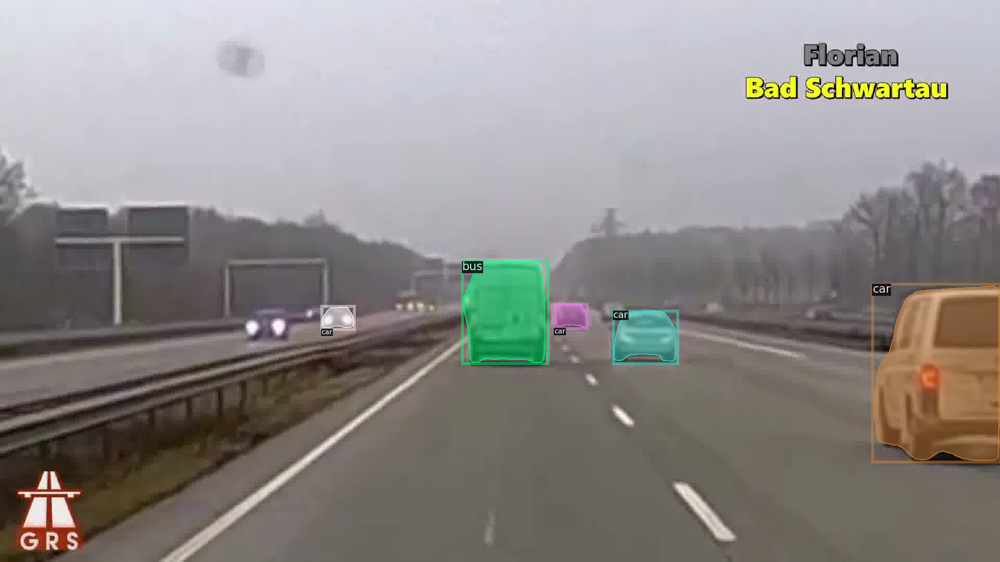

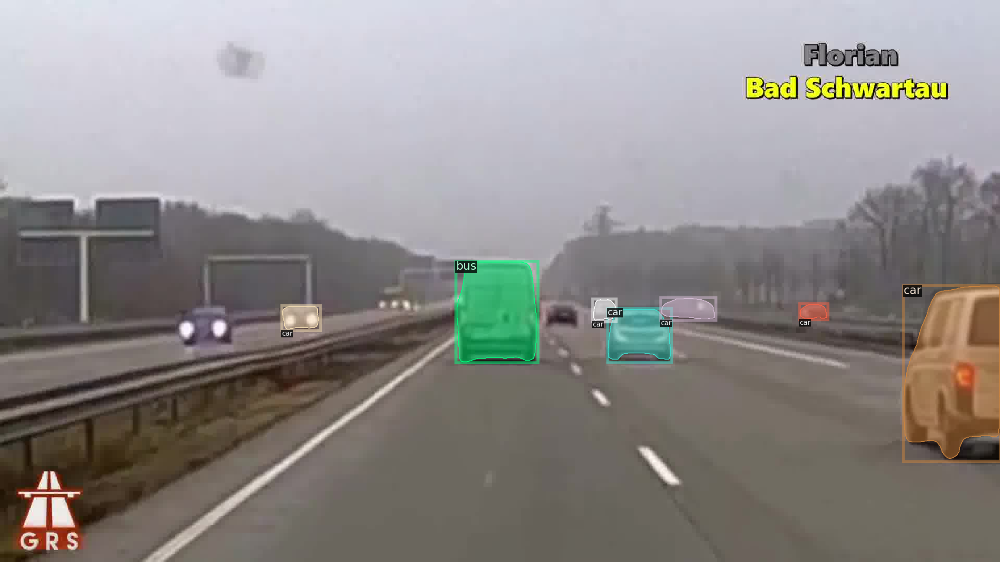

[array([[[247, 235, 223],
         [247, 235, 223],
         [247, 235, 223],
         ...,
         [236, 212, 206],
         [236, 212, 206],
         [236, 212, 206]],
 
        [[247, 235, 223],
         [247, 235, 223],
         [247, 235, 223],
         ...,
         [236, 212, 206],
         [236, 212, 206],
         [236, 212, 206]],
 
        [[247, 235, 223],
         [247, 235, 223],
         [247, 235, 223],
         ...,
         [236, 212, 206],
         [236, 212, 206],
         [236, 212, 206]],
 
        ...,
 
        [[ 32,  56,  68],
         [ 32,  56,  68],
         [ 32,  56,  68],
         ...,
         [109, 112, 117],
         [109, 112, 117],
         [109, 112, 117]],
 
        [[ 32,  56,  68],
         [ 32,  56,  68],
         [ 32,  56,  68],
         ...,
         [109, 112, 117],
         [109, 112, 117],
         [109, 112, 117]],
 
        [[ 32,  56,  68],
         [ 32,  56,  68],
         [ 32,  56,  68],
         ...,
         [109, 112, 117],
  

In [ ]:
track.Train_traker(predictor, cfg, images_path, view = True)